<a href="https://colab.research.google.com/github/huythong267/Pix2Pix_tensorflow_keras/blob/main/Pix2Pix.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

import os

# Pix2Pix

This notebook implements the Pix2Pix paper that addresses the image-to-image translation problem. The goal is to translate from an image of one type to another. This implemetation follows the structure of the offical tutorial from Tensorflow.

+ [Paper](https://arxiv.org/pdf/1611.07004.pdf)
+ [TensorFlow Official Tutorial](https://www.tensorflow.org/tutorials/generative/pix2pix)

We download the data, build input pipeline, construct the generator + disciminator, train the model with GAN + L1 loss, and generate images 

In [2]:
data_path = tf.keras.utils.get_file('facades.tar.gz', 'https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/facades.tar.gz', untar=True)
dir_path = os.path.dirname(data_path)

30171136/30168306 [==============================] - 9s 0us/step


# Input Pipeline

We use the tf.data API to build the input pipeline.      
For the training set, we augment the data by randomly cropping and horizonally flipping the images. 

In [3]:
def process_image(img_path, mode='train'):
    # Reads images from image path and convert to the 0-1 scale
    img = tf.image.decode_jpeg(tf.io.read_file(img_path))
    img = tf.cast(img, tf.float32) / 255.0

    # Separates into the input-output pairs
    y = img[:, :256, :]
    x = img[:, 256:, :]

    # Augments the training set with crop + flip
    if mode == 'train':
        concat_x_y = tf.concat([x, y], axis=-1)
        concat_x_y = tf.image.resize(concat_x_y, size=(300, 300))
        concat_x_y = tf.image.random_crop(concat_x_y, size=(256, 256, 6))
        if tf.random.uniform(shape=()) > 0.5:
            concat_x_y = tf.image.flip_left_right(concat_x_y)

        x =  concat_x_y[..., :3]
        y =  concat_x_y[..., 3:]

    return x, y

def build_ds(mode='train'):
    # Gets an image directory
    img_dir = os.path.join(dir_path, 'facades', mode)

    # Loads + transform data directly from an image directory
    ds = tf.data.Dataset.list_files(img_dir + '/*.jpg')
    return ds.map(lambda img_path: process_image(img_path, mode=mode))

# Builds the train, val, and test sets
train_ds = build_ds(mode='train')
val_ds = build_ds(mode='val')
test_ds = build_ds(mode='test')

Several examples of the training dataset

****************************************************************************************************


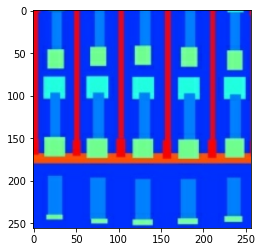

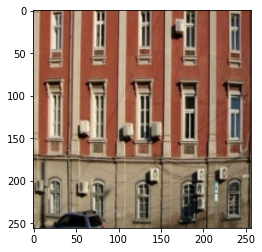

****************************************************************************************************


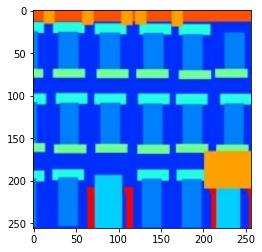

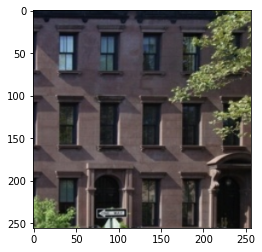

****************************************************************************************************


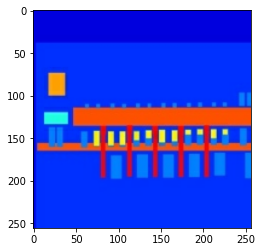

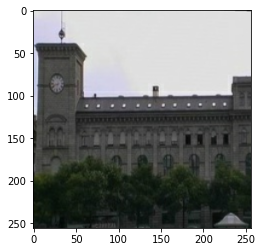

In [4]:
for x, y in train_ds.batch(5).take(3):
    print('*'*100)
    plt.imshow(x[0]); plt.show()
    plt.imshow(y[0]); plt.show()

# Models

We need to build a generator to tranlate from images to images. One of the critical specifications for the generator is that the generated images must "look real". I like the ideal that Ian Goodfellow can quantify the abstract concept of "looking real" from the GAN training and loss.

## Generators

The neural architecture for the generator follows the U-net. We declare the model, show the distribution of the output, and depict the computational graph.
One of the mistakes that I made was on missing the activation layer at the last stage of the transpose convolution.

Taking another perspective, this is the moment when AI can actually "***draw images***".

In [5]:
# Variables for the shape of the U-net
dim_nfilters_map = dim_nfilters_map = {
    128: 32, 
    64: 64, 
    32: 128, 
    16: 256, 
    8: 256, 
    4: 256, 
    2:256, 
    1: 256
}

class Generator(tf.keras.Model):
    def __init__(self,
                 dim_nfilters_map = dim_nfilters_map,
                 activation_conv=tf.keras.layers.LeakyReLU(alpha=0.1),
                 activation_conv_t=tf.keras.layers.ReLU(),
                 kernel_size=3,
                 rate=0.3):
        super().__init__()

        # Use string keys to ease the saved model in the later part
        self.dim_nfilters_map = {
            str(d): f for d, f in dim_nfilters_map.items()
        }
        self.dims = sorted(self.dim_nfilters_map.keys(), reverse=True, key=int)
        self.dropout_dims = self.dims[4:] 
        self.norm_dims = self.dims[2:]

        # dim reperesents the expected output dimension of the layers
        self.conv, self.conv_t = {}, {}
        for d, n_filters in self.dim_nfilters_map.items():
            self.conv[d] = tf.keras.layers.Conv2D(
                filters=n_filters, 
                kernel_size=kernel_size, 
                strides=2, 
                padding='same', 
                activation=activation_conv
            )
            # Upsample dim = downsample dim x 2, thus we skip the smallest dim
            if d != self.dims[-1]:
                self.conv_t[d] = tf.keras.layers.Conv2DTranspose(
                    filters=n_filters, 
                    kernel_size=kernel_size, 
                    strides=2, 
                    padding='same', 
                    activation=activation_conv_t
                )
        # Adds the last upsample layers
        self.conv_t['256'] = tf.keras.layers.Conv2DTranspose(
            filters=3,         # outputs an image with 3 channels
            kernel_size=kernel_size, 
            strides=2, 
            padding='same', 
            activation='sigmoid', # output range is from 0-1
        )

        # Adds dropout and layer normalization
        self.dropout = {
            d: tf.keras.layers.Dropout(rate=rate) for d in self.dropout_dims
        }
        self.norm = {
            d: tf.keras.layers.LayerNormalization() for d in self.norm_dims
        }

        self.dropout_t = {
            d: tf.keras.layers.Dropout(rate=rate) for d in self.dropout_dims
        }
        self.norm_t = {
            d: tf.keras.layers.LayerNormalization() for d in self.norm_dims
        }

    def call(self, x, training=False):
        # down-sample
        x_conv = {'256': x}
        for d in self.dims:
            x_conv[d] = self.conv[d](x_conv[str(int(d)*2)])

            if d in self.dropout_dims:
                x_conv[d] = self.dropout[d](x_conv[d], training=training)
            if d in self.norm_dims:
                x_conv[d] = self.norm[d](x_conv[d])

        # up-sample
        for d in self.dims[::-1]:
            if d == self.dims[-1]:
                concat_y = x_conv[d]
            else:
                concat_y = tf.keras.layers.Concatenate()([y, x_conv[d]])

            y = self.conv_t[str(int(d)*2)](concat_y)

            if d in self.dropout_dims:
                y = self.dropout_t[d](y, training=training)

            if d in self.norm_dims:
                y = self.norm_t[d](y)

        return y

    # Additional codes to print each step of the computational graph
    def view_model(self,):
        x = tf.keras.layers.Input(shape=(256, 256, 3))
        return tf.keras.Model(inputs=x, outputs=self.call(x))

Show examples of generated images with random initialization of trainable weights

****************************************************************************************************


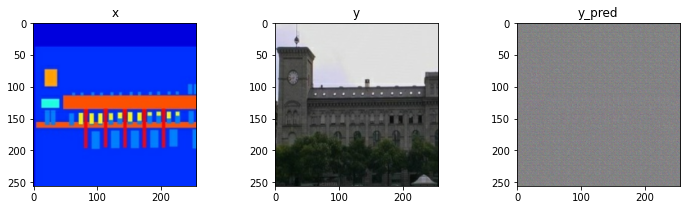

****************************************************************************************************


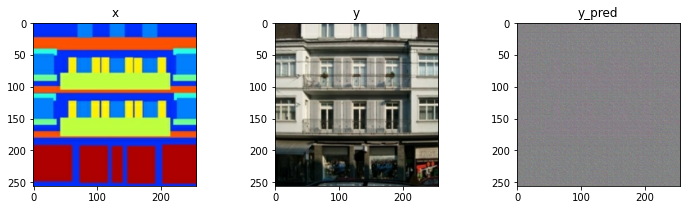

In [6]:
generator = Generator()
y_pred = generator(x)

plots = {'x': x, 'y': y, 'y_pred': y_pred}

for i in range(len(x))[:2]:
    print('*'*100)
    plt.figure(figsize=(12, 3))
    for idx, (title, img) in enumerate(plots.items()):
        plt.subplot(1, 3, idx + 1)
        plt.imshow(img[i])
        plt.title(title)
    plt.subplots_adjust(wspace=0.3)
    plt.show()

Show the distribution of pixels in generated images

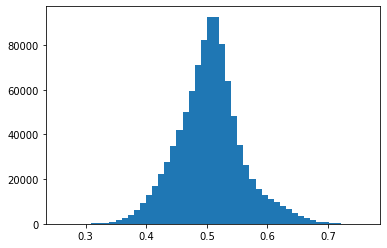

In [7]:
generator = Generator()
y_pred = generator(x)
plt.hist(tf.reshape(y_pred, (-1,)), bins=50); plt.show()

View the computational graph and the number of trainable parameters

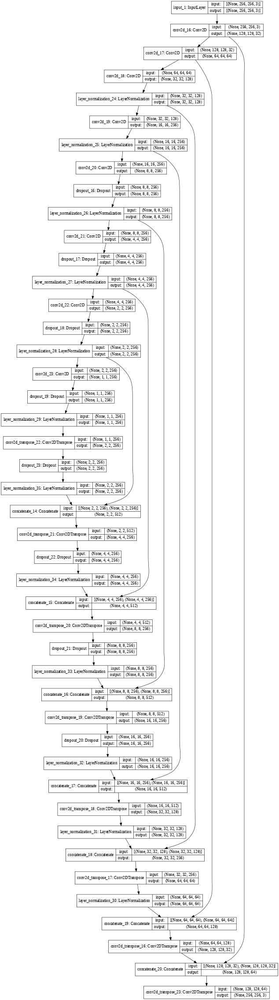

In [8]:
generator = Generator()
tf.keras.utils.plot_model(generator.view_model(), show_shapes=True, dpi=45)

In [9]:
generator.view_model().summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_16 (Conv2D)              (None, 128, 128, 32) 896         input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_17 (Conv2D)              (None, 64, 64, 64)   18496       conv2d_16[1][0]                  
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, 32, 32, 128)  73856       conv2d_17[1][0]                  
____________________________________________________________________________________________

## Discriminator

To train this generator, we construct a disciminator to tell us whether the generated images "look real".

Still find amazing that we can **quantify** the abstract concept of "look real" in mathematical terms.

In [10]:
class Discriminator(tf.keras.Model):
    def __init__(self, rate=0.3):
        super().__init__()

        self.conv, self.norm, self.dropout = {}, {}, {}
        # We use 5 + 1 convolutional layers in total for the discriminator
        self.layer_names = [str(n) for n in range(5)]
        for i in self.layer_names:
            self.conv[i] = tf.keras.layers.Conv2D(
                filters=64 if int(i) < 3 else 256, 
                kernel_size=5, 
                strides=2 if int(i) < 3 else 1, 
                padding='same', 
                activation='relu',
            )
            self.dropout[i] = tf.keras.layers.Dropout(rate=rate)
            self.norm[i] = tf.keras.layers.LayerNormalization()

        self.zero_pad = tf.keras.layers.ZeroPadding2D()
        self.conv_0 = tf.keras.layers.Conv2D(filters=1, kernel_size=5, strides=1, activation='sigmoid')

    def call(self, x0, y0, training=False):
        x = tf.keras.layers.Concatenate()([x0, y0])
        for i in self.layer_names:
            x = self.norm[i](x)
            x = self.dropout[i](x, training=training)
            x = self.conv[i](x)
        x = self.zero_pad(x)
        return self.conv_0(x)

    # Additional codes to print each step of the computational graph
    def view_model(self,):
        x = tf.keras.layers.Input(shape=(256, 256, 3))
        y = tf.keras.layers.Input(shape=(256, 256, 3))
        return tf.keras.Model(inputs=[x, y], outputs=self.call(x, y))

Plot the distribution

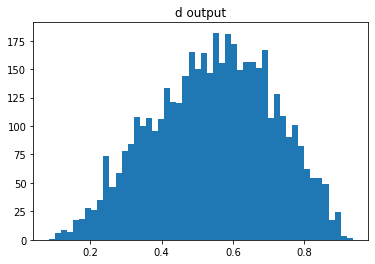

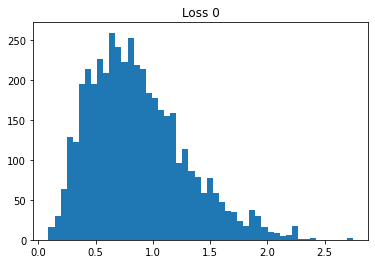

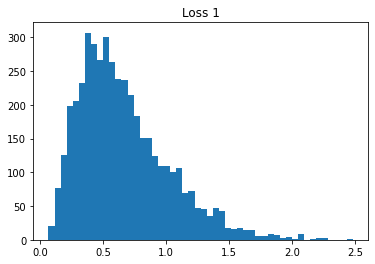

In [11]:
discriminator = Discriminator()
d = discriminator(x, y)
loss= tf.keras.losses.BinaryCrossentropy(reduction=tf.keras.losses.Reduction.NONE)
l0 = loss(tf.zeros_like(d), d)
l1 = loss(tf.ones_like(d), d)

plt.hist(tf.reshape(d, (-1,)), bins=50); plt.title('d output'); plt.show()
plt.hist(tf.reshape(l0, (-1,)), bins=50); plt.title('Loss 0'); plt.show()
plt.hist(tf.reshape(l1, (-1,)), bins=50); plt.title('Loss 1'); plt.show()

View the computational graph + the number of trainable weights

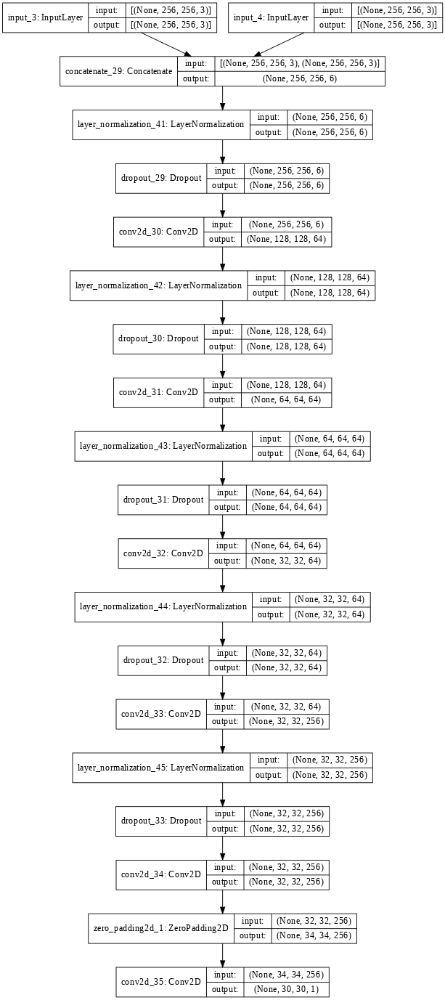

In [12]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator.view_model(), show_shapes=True, dpi=64)

In [13]:
discriminator.view_model().summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
input_6 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
concatenate_30 (Concatenate)    (None, 256, 256, 6)  0           input_5[0][0]                    
                                                                 input_6[0][0]                    
__________________________________________________________________________________________________
layer_normalization_41 (LayerNo (None, 256, 256, 6)  12          concatenate_30[0][0]       

## Train Step

The train step follows the standard GAN training. I feel things are quite clean to wrap everything inside methods of a tf.keras.Model

In [14]:
generator = Generator()
discriminator = Discriminator()

BCE_loss = tf.keras.losses.BinaryCrossentropy()

class GAN_model(tf.keras.Model):
    def __init__(self, dim_nfilters_map=dim_nfilters_map):
        super().__init__()
        self.generator = Generator(dim_nfilters_map=dim_nfilters_map)
        self.discriminator = Discriminator()
        self.loss_names = [
            'D_loss',
            'D_loss_true_images',
            'D_loss_gen_images',
            'G_loss',
            'G_loss_GAN',
            'G_loss_f1',]
        self.compile()

    def compile(self,):
        super().compile()
        self.optim_g = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
        self.optim_d = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

        self.metric = {}
        for loss_name in self.loss_names:
            self.metric[loss_name] = tf.keras.metrics.Mean(name=loss_name)


    @tf.function
    def train_step(self, data):

        x, y = data
        metric = {}

        with tf.GradientTape() as dtape, tf.GradientTape() as gtape:
            y_pred = self.generator(x, training=True)
            D_true = self.discriminator(x, y, training=True)
            D_gen = self.discriminator(x, y_pred, training=True)

            metric['G_loss_f1'] = tf.math.reduce_mean(tf.math.abs(y - y_pred))
            metric['G_loss_GAN'] = tf.math.reduce_mean(BCE_loss(tf.ones_like(D_gen), D_gen))
            metric['G_loss'] = metric['G_loss_GAN'] + 100 * metric['G_loss_f1']

            metric['D_loss_true_images'] = BCE_loss(tf.ones_like(D_true), D_true)
            metric['D_loss_gen_images'] = BCE_loss(tf.zeros_like(D_gen), D_gen)
            metric['D_loss'] = (metric['D_loss_true_images'] + metric['D_loss_gen_images']) / 2.0

        d_grads = dtape.gradient(metric['D_loss'], self.discriminator.trainable_variables)
        self.optim_d.apply_gradients(zip(d_grads, self.discriminator.trainable_variables))

        g_grads = gtape.gradient(metric['G_loss'], self.generator.trainable_variables)
        self.optim_g.apply_gradients(zip(g_grads, self.generator.trainable_variables))

        # Update metrics and output the average results
        for loss_name in self.loss_names:
            self.metric[loss_name].update_state(metric[loss_name])

        return {
            loss_name: self.metric[loss_name].result() for loss_name in self.loss_names
        }

# Image to Image Models

## Tensorboard

Call the tensorboard to view the training progress

In [15]:
log_dir = 'logs/fit/'

In [16]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

## Callbacks

We visualize the prediction of the generator on the validation set after the end of each epoch

In [17]:
class Visualize_callback(tf.keras.callbacks.Callback):
    def __init__(self,):
        super().__init__()
        self.iter = iter(val_ds.repeat().batch(1))

    def on_epoch_end(self, epoch, logs=None):
        if epoch % 5 == 0:
            x, y = self.iter.get_next()
            y_pred = self.model.generator(x)

            plots = {'x': x, 'y': y, 'y_pred': y_pred}

            plt.figure(figsize=(12, 3))
            for idx, (title, img) in enumerate(plots.items()):
                plt.subplot(1, 3, idx + 1)
                plt.imshow(img[0])
                plt.title('%s (%s)' %(title,epoch)); plt.axis('off')
            plt.subplots_adjust(wspace=0.3); plt.show()

## Train the Image-to-Image translation model

In [18]:
dim_nfilters_map = {128: 32, 64: 64, 32: 128, 16: 256, 8: 256, 4: 256, 2:256, 1: 256}
model = GAN_model(dim_nfilters_map=dim_nfilters_map)
model.generator.view_model().summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_50 (Conv2D)              (None, 128, 128, 32) 896         input_7[0][0]                    
__________________________________________________________________________________________________
conv2d_51 (Conv2D)              (None, 64, 64, 64)   18496       conv2d_50[0][0]                  
__________________________________________________________________________________________________
conv2d_52 (Conv2D)              (None, 32, 32, 128)  73856       conv2d_51[0][0]                  
____________________________________________________________________________________________

Epoch 1/250
200/200 [==============================] - 18s 39ms/step - D_loss: 0.4765 - D_loss_true_images: 0.4899 - D_loss_gen_images: 0.4631 - G_loss: 20.3828 - G_loss_GAN: 2.2615 - G_loss_f1: 0.1812


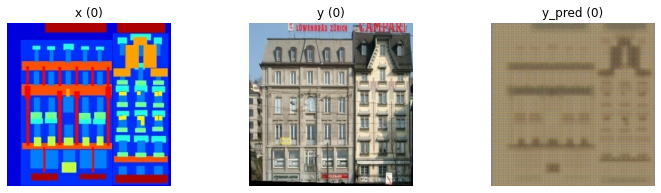

Epoch 2/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3183 - D_loss_true_images: 0.3410 - D_loss_gen_images: 0.2957 - G_loss: 20.8242 - G_loss_GAN: 2.7855 - G_loss_f1: 0.1804
Epoch 3/250
200/200 [==============================] - 10s 37ms/step - D_loss: 0.3369 - D_loss_true_images: 0.3689 - D_loss_gen_images: 0.3050 - G_loss: 20.2596 - G_loss_GAN: 2.4011 - G_loss_f1: 0.1786
Epoch 4/250
200/200 [==============================] - 10s 37ms/step - D_loss: 0.3462 - D_loss_true_images: 0.3815 - D_loss_gen_images: 0.3110 - G_loss: 19.7731 - G_loss_GAN: 2.2046 - G_loss_f1: 0.1757
Epoch 5/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3528 - D_loss_true_images: 0.3895 - D_loss_gen_images: 0.3161 - G_loss: 19.4576 - G_loss_GAN: 2.1040 - G_loss_f1: 0.1735
Epoch 6/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3602 - D_loss_true_images: 0.3977 - D_loss_gen_images: 0.3228 - G_loss: 19.2484 - G_loss_GAN: 2.0271 - G_loss_f

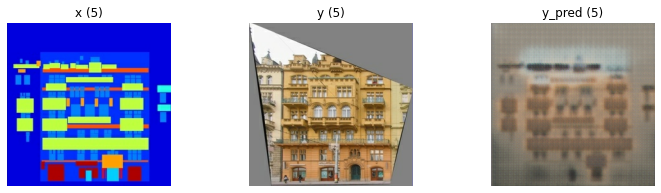

Epoch 7/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3668 - D_loss_true_images: 0.4032 - D_loss_gen_images: 0.3305 - G_loss: 19.1006 - G_loss_GAN: 1.9779 - G_loss_f1: 0.1712
Epoch 8/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3689 - D_loss_true_images: 0.4045 - D_loss_gen_images: 0.3333 - G_loss: 18.9860 - G_loss_GAN: 1.9497 - G_loss_f1: 0.1704
Epoch 9/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3670 - D_loss_true_images: 0.4026 - D_loss_gen_images: 0.3314 - G_loss: 18.9054 - G_loss_GAN: 1.9410 - G_loss_f1: 0.1696
Epoch 10/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3666 - D_loss_true_images: 0.4021 - D_loss_gen_images: 0.3311 - G_loss: 18.8379 - G_loss_GAN: 1.9298 - G_loss_f1: 0.1691
Epoch 11/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3649 - D_loss_true_images: 0.4007 - D_loss_gen_images: 0.3291 - G_loss: 18.7951 - G_loss_GAN: 1.9248 - G_loss

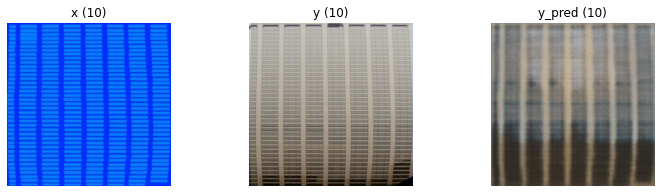

Epoch 12/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3620 - D_loss_true_images: 0.3979 - D_loss_gen_images: 0.3261 - G_loss: 18.7525 - G_loss_GAN: 1.9272 - G_loss_f1: 0.1683
Epoch 13/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3614 - D_loss_true_images: 0.3969 - D_loss_gen_images: 0.3258 - G_loss: 18.7193 - G_loss_GAN: 1.9235 - G_loss_f1: 0.1680
Epoch 14/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3614 - D_loss_true_images: 0.3965 - D_loss_gen_images: 0.3263 - G_loss: 18.6806 - G_loss_GAN: 1.9192 - G_loss_f1: 0.1676
Epoch 15/250
200/200 [==============================] - 10s 38ms/step - D_loss: 0.3616 - D_loss_true_images: 0.3965 - D_loss_gen_images: 0.3267 - G_loss: 18.6426 - G_loss_GAN: 1.9139 - G_loss_f1: 0.1673
Epoch 16/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3617 - D_loss_true_images: 0.3965 - D_loss_gen_images: 0.3268 - G_loss: 18.6085 - G_loss_GAN: 1.9078 - G_l

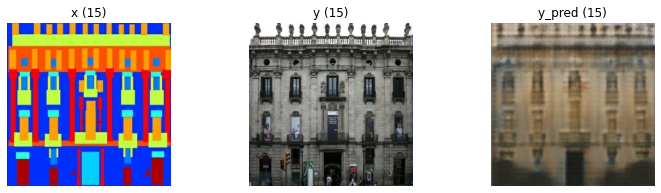

Epoch 17/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3617 - D_loss_true_images: 0.3962 - D_loss_gen_images: 0.3272 - G_loss: 18.5779 - G_loss_GAN: 1.9043 - G_loss_f1: 0.1667
Epoch 18/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3617 - D_loss_true_images: 0.3958 - D_loss_gen_images: 0.3276 - G_loss: 18.5497 - G_loss_GAN: 1.9039 - G_loss_f1: 0.1665
Epoch 19/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3624 - D_loss_true_images: 0.3963 - D_loss_gen_images: 0.3285 - G_loss: 18.5206 - G_loss_GAN: 1.9003 - G_loss_f1: 0.1662
Epoch 20/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3628 - D_loss_true_images: 0.3964 - D_loss_gen_images: 0.3292 - G_loss: 18.4844 - G_loss_GAN: 1.8971 - G_loss_f1: 0.1659
Epoch 21/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3631 - D_loss_true_images: 0.3962 - D_loss_gen_images: 0.3299 - G_loss: 18.4694 - G_loss_GAN: 1.8956 - G_l

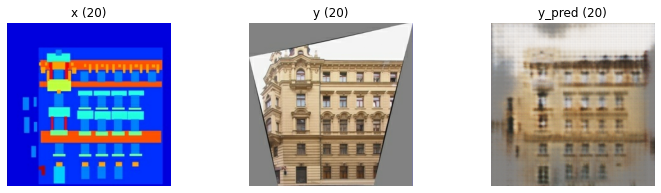

Epoch 22/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3632 - D_loss_true_images: 0.3964 - D_loss_gen_images: 0.3300 - G_loss: 18.4315 - G_loss_GAN: 1.8934 - G_loss_f1: 0.1654
Epoch 23/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3630 - D_loss_true_images: 0.3962 - D_loss_gen_images: 0.3298 - G_loss: 18.4183 - G_loss_GAN: 1.8925 - G_loss_f1: 0.1653
Epoch 24/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3635 - D_loss_true_images: 0.3963 - D_loss_gen_images: 0.3306 - G_loss: 18.3980 - G_loss_GAN: 1.8908 - G_loss_f1: 0.1651
Epoch 25/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3638 - D_loss_true_images: 0.3965 - D_loss_gen_images: 0.3311 - G_loss: 18.3727 - G_loss_GAN: 1.8885 - G_loss_f1: 0.1648
Epoch 26/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3639 - D_loss_true_images: 0.3964 - D_loss_gen_images: 0.3313 - G_loss: 18.3507 - G_loss_GAN: 1.8873 - G_l

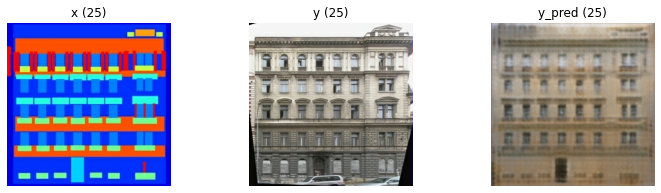

Epoch 27/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3638 - D_loss_true_images: 0.3962 - D_loss_gen_images: 0.3315 - G_loss: 18.3375 - G_loss_GAN: 1.8871 - G_loss_f1: 0.1645
Epoch 28/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3637 - D_loss_true_images: 0.3960 - D_loss_gen_images: 0.3314 - G_loss: 18.3124 - G_loss_GAN: 1.8870 - G_loss_f1: 0.1643
Epoch 29/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3639 - D_loss_true_images: 0.3961 - D_loss_gen_images: 0.3318 - G_loss: 18.2889 - G_loss_GAN: 1.8855 - G_loss_f1: 0.1640
Epoch 30/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3639 - D_loss_true_images: 0.3960 - D_loss_gen_images: 0.3319 - G_loss: 18.2613 - G_loss_GAN: 1.8855 - G_loss_f1: 0.1638
Epoch 31/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3637 - D_loss_true_images: 0.3957 - D_loss_gen_images: 0.3318 - G_loss: 18.2402 - G_loss_GAN: 1.8861 - G_l

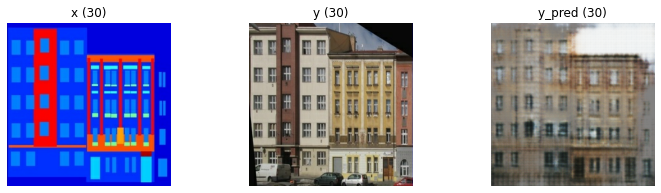

Epoch 32/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3640 - D_loss_true_images: 0.3958 - D_loss_gen_images: 0.3322 - G_loss: 18.2157 - G_loss_GAN: 1.8853 - G_loss_f1: 0.1633
Epoch 33/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3643 - D_loss_true_images: 0.3959 - D_loss_gen_images: 0.3327 - G_loss: 18.1961 - G_loss_GAN: 1.8850 - G_loss_f1: 0.1631
Epoch 34/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3647 - D_loss_true_images: 0.3961 - D_loss_gen_images: 0.3333 - G_loss: 18.1773 - G_loss_GAN: 1.8836 - G_loss_f1: 0.1629
Epoch 35/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3651 - D_loss_true_images: 0.3962 - D_loss_gen_images: 0.3339 - G_loss: 18.1549 - G_loss_GAN: 1.8825 - G_loss_f1: 0.1627
Epoch 36/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3655 - D_loss_true_images: 0.3964 - D_loss_gen_images: 0.3347 - G_loss: 18.1314 - G_loss_GAN: 1.8810 - G_l

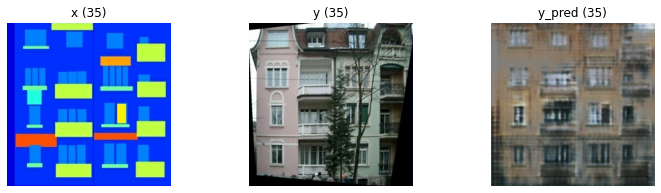

Epoch 37/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3657 - D_loss_true_images: 0.3965 - D_loss_gen_images: 0.3349 - G_loss: 18.1123 - G_loss_GAN: 1.8806 - G_loss_f1: 0.1623
Epoch 38/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3659 - D_loss_true_images: 0.3967 - D_loss_gen_images: 0.3352 - G_loss: 18.0903 - G_loss_GAN: 1.8795 - G_loss_f1: 0.1621
Epoch 39/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3660 - D_loss_true_images: 0.3967 - D_loss_gen_images: 0.3353 - G_loss: 18.0730 - G_loss_GAN: 1.8792 - G_loss_f1: 0.1619
Epoch 40/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3661 - D_loss_true_images: 0.3967 - D_loss_gen_images: 0.3355 - G_loss: 18.0537 - G_loss_GAN: 1.8792 - G_loss_f1: 0.1617
Epoch 41/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3666 - D_loss_true_images: 0.3969 - D_loss_gen_images: 0.3362 - G_loss: 18.0331 - G_loss_GAN: 1.8780 - G_l

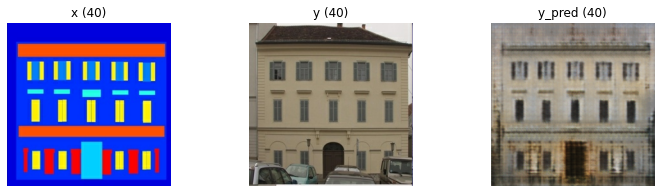

Epoch 42/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3671 - D_loss_true_images: 0.3973 - D_loss_gen_images: 0.3370 - G_loss: 18.0123 - G_loss_GAN: 1.8769 - G_loss_f1: 0.1614
Epoch 43/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3675 - D_loss_true_images: 0.3976 - D_loss_gen_images: 0.3375 - G_loss: 17.9969 - G_loss_GAN: 1.8758 - G_loss_f1: 0.1612
Epoch 44/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3678 - D_loss_true_images: 0.3978 - D_loss_gen_images: 0.3378 - G_loss: 17.9790 - G_loss_GAN: 1.8746 - G_loss_f1: 0.1610
Epoch 45/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3679 - D_loss_true_images: 0.3978 - D_loss_gen_images: 0.3381 - G_loss: 17.9575 - G_loss_GAN: 1.8747 - G_loss_f1: 0.1608
Epoch 46/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3683 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3386 - G_loss: 17.9369 - G_loss_GAN: 1.8738 - G_l

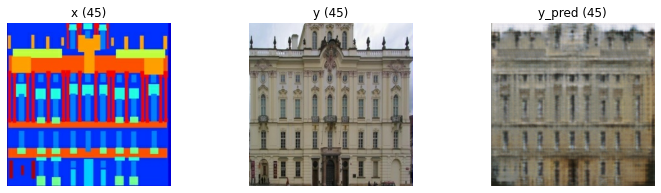

Epoch 47/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3685 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3389 - G_loss: 17.9210 - G_loss_GAN: 1.8743 - G_loss_f1: 0.1605
Epoch 48/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3686 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3393 - G_loss: 17.9026 - G_loss_GAN: 1.8744 - G_loss_f1: 0.1603
Epoch 49/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3688 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3395 - G_loss: 17.8840 - G_loss_GAN: 1.8748 - G_loss_f1: 0.1601
Epoch 50/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3689 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3399 - G_loss: 17.8676 - G_loss_GAN: 1.8751 - G_loss_f1: 0.1599
Epoch 51/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3691 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3403 - G_loss: 17.8483 - G_loss_GAN: 1.8754 - G_l

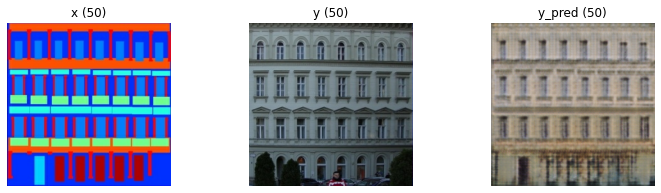

Epoch 52/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3694 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3409 - G_loss: 17.8300 - G_loss_GAN: 1.8757 - G_loss_f1: 0.1595
Epoch 53/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3700 - D_loss_true_images: 0.3983 - D_loss_gen_images: 0.3417 - G_loss: 17.8116 - G_loss_GAN: 1.8750 - G_loss_f1: 0.1594
Epoch 54/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3705 - D_loss_true_images: 0.3987 - D_loss_gen_images: 0.3424 - G_loss: 17.7892 - G_loss_GAN: 1.8737 - G_loss_f1: 0.1592
Epoch 55/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3707 - D_loss_true_images: 0.3986 - D_loss_gen_images: 0.3428 - G_loss: 17.7731 - G_loss_GAN: 1.8745 - G_loss_f1: 0.1590
Epoch 56/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3709 - D_loss_true_images: 0.3988 - D_loss_gen_images: 0.3431 - G_loss: 17.7565 - G_loss_GAN: 1.8745 - G_l

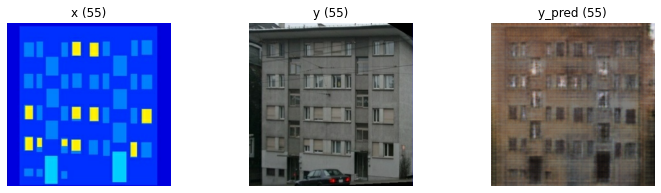

Epoch 57/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3710 - D_loss_true_images: 0.3987 - D_loss_gen_images: 0.3434 - G_loss: 17.7381 - G_loss_GAN: 1.8751 - G_loss_f1: 0.1586
Epoch 58/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3711 - D_loss_true_images: 0.3986 - D_loss_gen_images: 0.3436 - G_loss: 17.7193 - G_loss_GAN: 1.8756 - G_loss_f1: 0.1584
Epoch 59/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3712 - D_loss_true_images: 0.3985 - D_loss_gen_images: 0.3438 - G_loss: 17.7010 - G_loss_GAN: 1.8764 - G_loss_f1: 0.1582
Epoch 60/250
200/200 [==============================] - 10s 39ms/step - D_loss: 0.3713 - D_loss_true_images: 0.3985 - D_loss_gen_images: 0.3440 - G_loss: 17.6841 - G_loss_GAN: 1.8772 - G_loss_f1: 0.1581
Epoch 61/250
200/200 [==============================] - 11s 39ms/step - D_loss: 0.3713 - D_loss_true_images: 0.3984 - D_loss_gen_images: 0.3442 - G_loss: 17.6648 - G_loss_GAN: 1.8778 - G_l

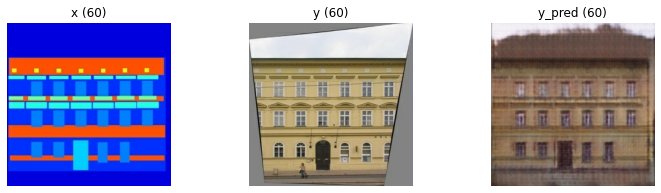

Epoch 62/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3714 - D_loss_true_images: 0.3983 - D_loss_gen_images: 0.3444 - G_loss: 17.6467 - G_loss_GAN: 1.8785 - G_loss_f1: 0.1577
Epoch 63/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3715 - D_loss_true_images: 0.3983 - D_loss_gen_images: 0.3447 - G_loss: 17.6307 - G_loss_GAN: 1.8791 - G_loss_f1: 0.1575
Epoch 64/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3715 - D_loss_true_images: 0.3981 - D_loss_gen_images: 0.3449 - G_loss: 17.6109 - G_loss_GAN: 1.8799 - G_loss_f1: 0.1573
Epoch 65/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3716 - D_loss_true_images: 0.3980 - D_loss_gen_images: 0.3452 - G_loss: 17.5946 - G_loss_GAN: 1.8809 - G_loss_f1: 0.1571
Epoch 66/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3717 - D_loss_true_images: 0.3979 - D_loss_gen_images: 0.3455 - G_loss: 17.5761 - G_loss_GAN: 1.8813 - G_l

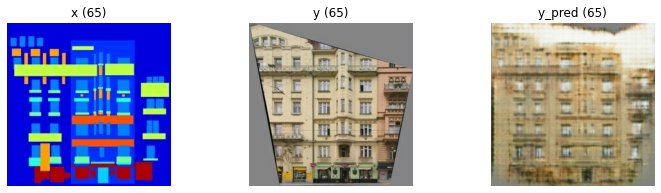

Epoch 67/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3717 - D_loss_true_images: 0.3977 - D_loss_gen_images: 0.3457 - G_loss: 17.5606 - G_loss_GAN: 1.8828 - G_loss_f1: 0.1568
Epoch 68/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3719 - D_loss_true_images: 0.3977 - D_loss_gen_images: 0.3460 - G_loss: 17.5436 - G_loss_GAN: 1.8834 - G_loss_f1: 0.1566
Epoch 69/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3719 - D_loss_true_images: 0.3976 - D_loss_gen_images: 0.3462 - G_loss: 17.5262 - G_loss_GAN: 1.8842 - G_loss_f1: 0.1564
Epoch 70/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3720 - D_loss_true_images: 0.3976 - D_loss_gen_images: 0.3465 - G_loss: 17.5077 - G_loss_GAN: 1.8847 - G_loss_f1: 0.1562
Epoch 71/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3720 - D_loss_true_images: 0.3974 - D_loss_gen_images: 0.3467 - G_loss: 17.4922 - G_loss_GAN: 1.8862 - G_l

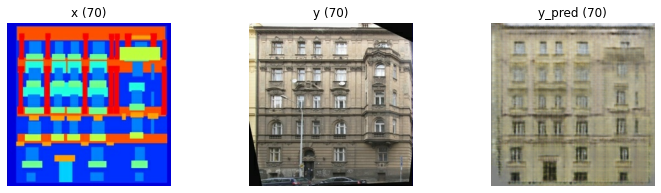

Epoch 72/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3720 - D_loss_true_images: 0.3972 - D_loss_gen_images: 0.3468 - G_loss: 17.4754 - G_loss_GAN: 1.8874 - G_loss_f1: 0.1559
Epoch 73/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3721 - D_loss_true_images: 0.3972 - D_loss_gen_images: 0.3471 - G_loss: 17.4604 - G_loss_GAN: 1.8883 - G_loss_f1: 0.1557
Epoch 74/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3721 - D_loss_true_images: 0.3969 - D_loss_gen_images: 0.3472 - G_loss: 17.4458 - G_loss_GAN: 1.8899 - G_loss_f1: 0.1556
Epoch 75/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3720 - D_loss_true_images: 0.3967 - D_loss_gen_images: 0.3472 - G_loss: 17.4298 - G_loss_GAN: 1.8918 - G_loss_f1: 0.1554
Epoch 76/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3719 - D_loss_true_images: 0.3965 - D_loss_gen_images: 0.3473 - G_loss: 17.4151 - G_loss_GAN: 1.8935 - G_l

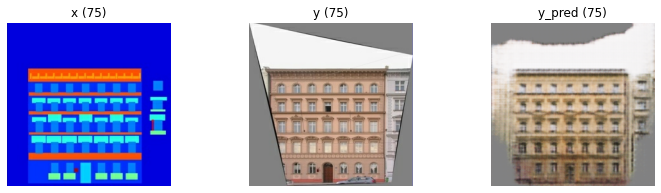

Epoch 77/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3719 - D_loss_true_images: 0.3964 - D_loss_gen_images: 0.3475 - G_loss: 17.3988 - G_loss_GAN: 1.8949 - G_loss_f1: 0.1550
Epoch 78/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3717 - D_loss_true_images: 0.3960 - D_loss_gen_images: 0.3474 - G_loss: 17.3857 - G_loss_GAN: 1.8972 - G_loss_f1: 0.1549
Epoch 79/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3718 - D_loss_true_images: 0.3959 - D_loss_gen_images: 0.3476 - G_loss: 17.3694 - G_loss_GAN: 1.8984 - G_loss_f1: 0.1547
Epoch 80/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3718 - D_loss_true_images: 0.3958 - D_loss_gen_images: 0.3478 - G_loss: 17.3519 - G_loss_GAN: 1.8997 - G_loss_f1: 0.1545
Epoch 81/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3718 - D_loss_true_images: 0.3957 - D_loss_gen_images: 0.3480 - G_loss: 17.3371 - G_loss_GAN: 1.9010 - G_l

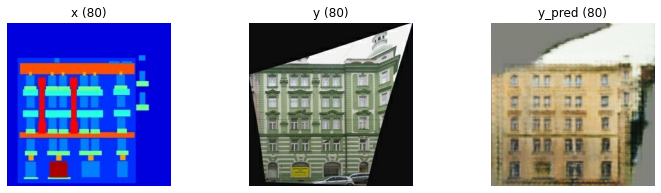

Epoch 82/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3718 - D_loss_true_images: 0.3955 - D_loss_gen_images: 0.3481 - G_loss: 17.3205 - G_loss_GAN: 1.9025 - G_loss_f1: 0.1542
Epoch 83/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3717 - D_loss_true_images: 0.3953 - D_loss_gen_images: 0.3481 - G_loss: 17.3060 - G_loss_GAN: 1.9046 - G_loss_f1: 0.1540
Epoch 84/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3716 - D_loss_true_images: 0.3950 - D_loss_gen_images: 0.3481 - G_loss: 17.2905 - G_loss_GAN: 1.9066 - G_loss_f1: 0.1538
Epoch 85/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3715 - D_loss_true_images: 0.3947 - D_loss_gen_images: 0.3482 - G_loss: 17.2756 - G_loss_GAN: 1.9085 - G_loss_f1: 0.1537
Epoch 86/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3714 - D_loss_true_images: 0.3946 - D_loss_gen_images: 0.3483 - G_loss: 17.2597 - G_loss_GAN: 1.9102 - G_l

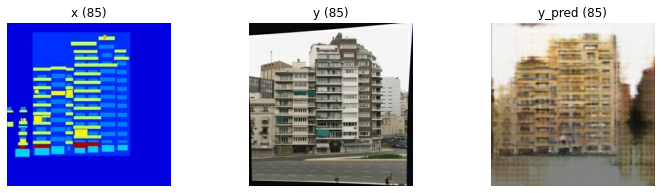

Epoch 87/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3714 - D_loss_true_images: 0.3944 - D_loss_gen_images: 0.3484 - G_loss: 17.2425 - G_loss_GAN: 1.9115 - G_loss_f1: 0.1533
Epoch 88/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3713 - D_loss_true_images: 0.3941 - D_loss_gen_images: 0.3484 - G_loss: 17.2288 - G_loss_GAN: 1.9137 - G_loss_f1: 0.1532
Epoch 89/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3712 - D_loss_true_images: 0.3938 - D_loss_gen_images: 0.3485 - G_loss: 17.2119 - G_loss_GAN: 1.9161 - G_loss_f1: 0.1530
Epoch 90/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3710 - D_loss_true_images: 0.3935 - D_loss_gen_images: 0.3485 - G_loss: 17.1978 - G_loss_GAN: 1.9184 - G_loss_f1: 0.1528
Epoch 91/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3709 - D_loss_true_images: 0.3932 - D_loss_gen_images: 0.3485 - G_loss: 17.1836 - G_loss_GAN: 1.9210 - G_l

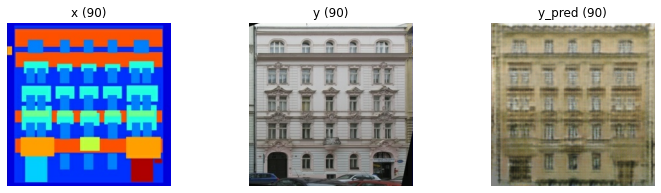

Epoch 92/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3706 - D_loss_true_images: 0.3929 - D_loss_gen_images: 0.3484 - G_loss: 17.1692 - G_loss_GAN: 1.9239 - G_loss_f1: 0.1525
Epoch 93/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3704 - D_loss_true_images: 0.3925 - D_loss_gen_images: 0.3483 - G_loss: 17.1564 - G_loss_GAN: 1.9271 - G_loss_f1: 0.1523
Epoch 94/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3703 - D_loss_true_images: 0.3922 - D_loss_gen_images: 0.3484 - G_loss: 17.1409 - G_loss_GAN: 1.9291 - G_loss_f1: 0.1521
Epoch 95/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3702 - D_loss_true_images: 0.3920 - D_loss_gen_images: 0.3484 - G_loss: 17.1263 - G_loss_GAN: 1.9314 - G_loss_f1: 0.1519
Epoch 96/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3700 - D_loss_true_images: 0.3917 - D_loss_gen_images: 0.3483 - G_loss: 17.1113 - G_loss_GAN: 1.9339 - G_l

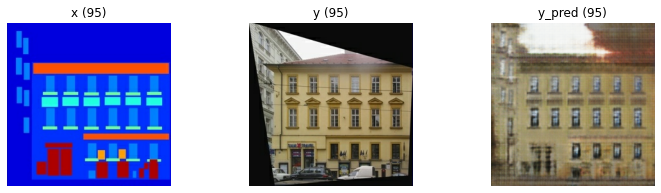

Epoch 97/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3698 - D_loss_true_images: 0.3913 - D_loss_gen_images: 0.3483 - G_loss: 17.0980 - G_loss_GAN: 1.9364 - G_loss_f1: 0.1516
Epoch 98/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3696 - D_loss_true_images: 0.3910 - D_loss_gen_images: 0.3482 - G_loss: 17.0827 - G_loss_GAN: 1.9389 - G_loss_f1: 0.1514
Epoch 99/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3694 - D_loss_true_images: 0.3907 - D_loss_gen_images: 0.3482 - G_loss: 17.0681 - G_loss_GAN: 1.9416 - G_loss_f1: 0.1513
Epoch 100/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3693 - D_loss_true_images: 0.3903 - D_loss_gen_images: 0.3482 - G_loss: 17.0546 - G_loss_GAN: 1.9443 - G_loss_f1: 0.1511
Epoch 101/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3691 - D_loss_true_images: 0.3900 - D_loss_gen_images: 0.3481 - G_loss: 17.0429 - G_loss_GAN: 1.9469 - G

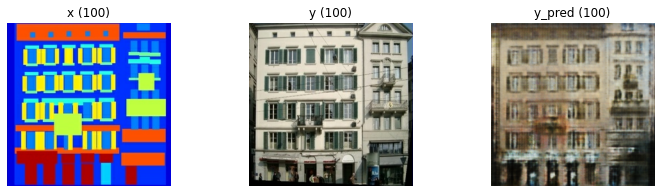

Epoch 102/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3689 - D_loss_true_images: 0.3897 - D_loss_gen_images: 0.3481 - G_loss: 17.0288 - G_loss_GAN: 1.9495 - G_loss_f1: 0.1508
Epoch 103/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3689 - D_loss_true_images: 0.3895 - D_loss_gen_images: 0.3482 - G_loss: 17.0139 - G_loss_GAN: 1.9515 - G_loss_f1: 0.1506
Epoch 104/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3687 - D_loss_true_images: 0.3892 - D_loss_gen_images: 0.3483 - G_loss: 17.0011 - G_loss_GAN: 1.9538 - G_loss_f1: 0.1505
Epoch 105/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3685 - D_loss_true_images: 0.3889 - D_loss_gen_images: 0.3481 - G_loss: 16.9876 - G_loss_GAN: 1.9568 - G_loss_f1: 0.1503
Epoch 106/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3683 - D_loss_true_images: 0.3886 - D_loss_gen_images: 0.3480 - G_loss: 16.9737 - G_loss_GAN: 1.9595 

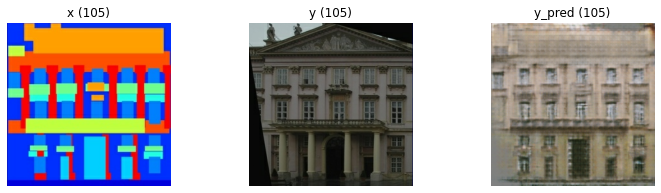

Epoch 107/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3681 - D_loss_true_images: 0.3882 - D_loss_gen_images: 0.3480 - G_loss: 16.9600 - G_loss_GAN: 1.9623 - G_loss_f1: 0.1500
Epoch 108/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3679 - D_loss_true_images: 0.3879 - D_loss_gen_images: 0.3479 - G_loss: 16.9468 - G_loss_GAN: 1.9651 - G_loss_f1: 0.1498
Epoch 109/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3676 - D_loss_true_images: 0.3875 - D_loss_gen_images: 0.3477 - G_loss: 16.9341 - G_loss_GAN: 1.9680 - G_loss_f1: 0.1497
Epoch 110/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3674 - D_loss_true_images: 0.3872 - D_loss_gen_images: 0.3476 - G_loss: 16.9212 - G_loss_GAN: 1.9709 - G_loss_f1: 0.1495
Epoch 111/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3671 - D_loss_true_images: 0.3867 - D_loss_gen_images: 0.3475 - G_loss: 16.9106 - G_loss_GAN: 1.9745 

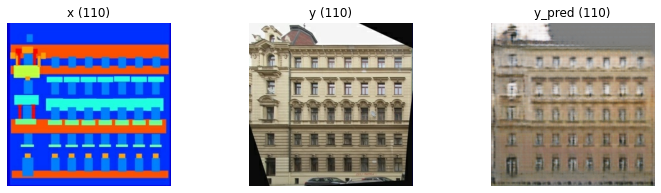

Epoch 112/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3668 - D_loss_true_images: 0.3863 - D_loss_gen_images: 0.3473 - G_loss: 16.8987 - G_loss_GAN: 1.9779 - G_loss_f1: 0.1492
Epoch 113/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3666 - D_loss_true_images: 0.3860 - D_loss_gen_images: 0.3473 - G_loss: 16.8871 - G_loss_GAN: 1.9808 - G_loss_f1: 0.1491
Epoch 114/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3664 - D_loss_true_images: 0.3856 - D_loss_gen_images: 0.3472 - G_loss: 16.8754 - G_loss_GAN: 1.9837 - G_loss_f1: 0.1489
Epoch 115/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3661 - D_loss_true_images: 0.3852 - D_loss_gen_images: 0.3471 - G_loss: 16.8645 - G_loss_GAN: 1.9873 - G_loss_f1: 0.1488
Epoch 116/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3659 - D_loss_true_images: 0.3848 - D_loss_gen_images: 0.3470 - G_loss: 16.8511 - G_loss_GAN: 1.9905 

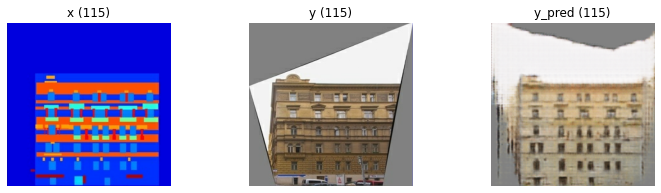

Epoch 117/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3656 - D_loss_true_images: 0.3844 - D_loss_gen_images: 0.3467 - G_loss: 16.8411 - G_loss_GAN: 1.9939 - G_loss_f1: 0.1485
Epoch 118/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3653 - D_loss_true_images: 0.3840 - D_loss_gen_images: 0.3466 - G_loss: 16.8295 - G_loss_GAN: 1.9970 - G_loss_f1: 0.1483
Epoch 119/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3651 - D_loss_true_images: 0.3837 - D_loss_gen_images: 0.3465 - G_loss: 16.8181 - G_loss_GAN: 2.0001 - G_loss_f1: 0.1482
Epoch 120/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3648 - D_loss_true_images: 0.3833 - D_loss_gen_images: 0.3463 - G_loss: 16.8069 - G_loss_GAN: 2.0034 - G_loss_f1: 0.1480
Epoch 121/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3646 - D_loss_true_images: 0.3829 - D_loss_gen_images: 0.3462 - G_loss: 16.7962 - G_loss_GAN: 2.0067 

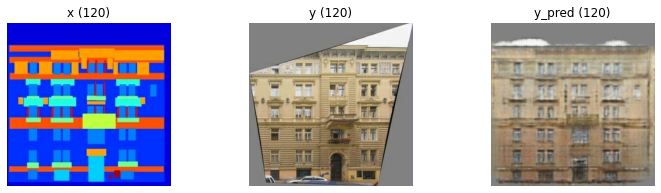

Epoch 122/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3643 - D_loss_true_images: 0.3825 - D_loss_gen_images: 0.3461 - G_loss: 16.7849 - G_loss_GAN: 2.0100 - G_loss_f1: 0.1477
Epoch 123/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3641 - D_loss_true_images: 0.3822 - D_loss_gen_images: 0.3459 - G_loss: 16.7743 - G_loss_GAN: 2.0132 - G_loss_f1: 0.1476
Epoch 124/250
200/200 [==============================] - 11s 40ms/step - D_loss: 0.3637 - D_loss_true_images: 0.3817 - D_loss_gen_images: 0.3457 - G_loss: 16.7634 - G_loss_GAN: 2.0168 - G_loss_f1: 0.1475
Epoch 125/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3634 - D_loss_true_images: 0.3813 - D_loss_gen_images: 0.3455 - G_loss: 16.7545 - G_loss_GAN: 2.0206 - G_loss_f1: 0.1473
Epoch 126/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3632 - D_loss_true_images: 0.3809 - D_loss_gen_images: 0.3454 - G_loss: 16.7441 - G_loss_GAN: 2.0243 

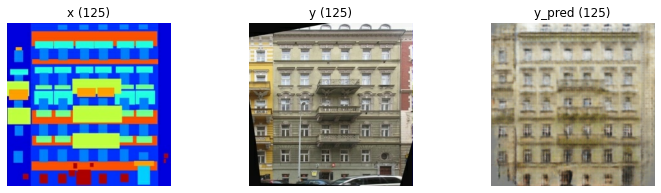

Epoch 127/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3629 - D_loss_true_images: 0.3806 - D_loss_gen_images: 0.3452 - G_loss: 16.7332 - G_loss_GAN: 2.0276 - G_loss_f1: 0.1471
Epoch 128/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3626 - D_loss_true_images: 0.3802 - D_loss_gen_images: 0.3451 - G_loss: 16.7223 - G_loss_GAN: 2.0311 - G_loss_f1: 0.1469
Epoch 129/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3623 - D_loss_true_images: 0.3798 - D_loss_gen_images: 0.3449 - G_loss: 16.7126 - G_loss_GAN: 2.0350 - G_loss_f1: 0.1468
Epoch 130/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3620 - D_loss_true_images: 0.3794 - D_loss_gen_images: 0.3446 - G_loss: 16.7021 - G_loss_GAN: 2.0387 - G_loss_f1: 0.1466
Epoch 131/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3617 - D_loss_true_images: 0.3790 - D_loss_gen_images: 0.3444 - G_loss: 16.6921 - G_loss_GAN: 2.0423 

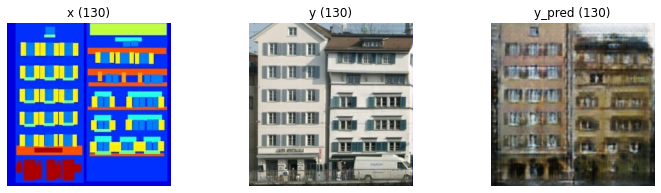

Epoch 132/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3613 - D_loss_true_images: 0.3785 - D_loss_gen_images: 0.3441 - G_loss: 16.6823 - G_loss_GAN: 2.0462 - G_loss_f1: 0.1464
Epoch 133/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3611 - D_loss_true_images: 0.3782 - D_loss_gen_images: 0.3440 - G_loss: 16.6711 - G_loss_GAN: 2.0494 - G_loss_f1: 0.1462
Epoch 134/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3608 - D_loss_true_images: 0.3778 - D_loss_gen_images: 0.3438 - G_loss: 16.6617 - G_loss_GAN: 2.0531 - G_loss_f1: 0.1461
Epoch 135/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3605 - D_loss_true_images: 0.3774 - D_loss_gen_images: 0.3436 - G_loss: 16.6527 - G_loss_GAN: 2.0567 - G_loss_f1: 0.1460
Epoch 136/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3602 - D_loss_true_images: 0.3769 - D_loss_gen_images: 0.3434 - G_loss: 16.6435 - G_loss_GAN: 2.0605 

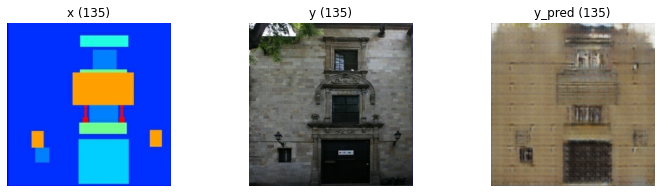

Epoch 137/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3598 - D_loss_true_images: 0.3765 - D_loss_gen_images: 0.3432 - G_loss: 16.6336 - G_loss_GAN: 2.0642 - G_loss_f1: 0.1457
Epoch 138/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3596 - D_loss_true_images: 0.3761 - D_loss_gen_images: 0.3430 - G_loss: 16.6247 - G_loss_GAN: 2.0678 - G_loss_f1: 0.1456
Epoch 139/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3593 - D_loss_true_images: 0.3757 - D_loss_gen_images: 0.3428 - G_loss: 16.6152 - G_loss_GAN: 2.0714 - G_loss_f1: 0.1454
Epoch 140/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3589 - D_loss_true_images: 0.3753 - D_loss_gen_images: 0.3425 - G_loss: 16.6060 - G_loss_GAN: 2.0754 - G_loss_f1: 0.1453
Epoch 141/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3585 - D_loss_true_images: 0.3748 - D_loss_gen_images: 0.3423 - G_loss: 16.5958 - G_loss_GAN: 2.0794 

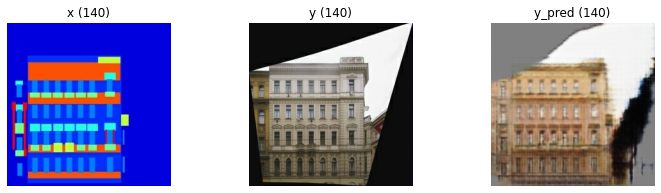

Epoch 142/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3582 - D_loss_true_images: 0.3744 - D_loss_gen_images: 0.3421 - G_loss: 16.5873 - G_loss_GAN: 2.0831 - G_loss_f1: 0.1450
Epoch 143/250
200/200 [==============================] - 11s 41ms/step - D_loss: 0.3579 - D_loss_true_images: 0.3740 - D_loss_gen_images: 0.3418 - G_loss: 16.5788 - G_loss_GAN: 2.0869 - G_loss_f1: 0.1449
Epoch 144/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3575 - D_loss_true_images: 0.3735 - D_loss_gen_images: 0.3415 - G_loss: 16.5707 - G_loss_GAN: 2.0913 - G_loss_f1: 0.1448
Epoch 145/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3572 - D_loss_true_images: 0.3731 - D_loss_gen_images: 0.3413 - G_loss: 16.5608 - G_loss_GAN: 2.0948 - G_loss_f1: 0.1447
Epoch 146/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3568 - D_loss_true_images: 0.3726 - D_loss_gen_images: 0.3410 - G_loss: 16.5523 - G_loss_GAN: 2.0990 

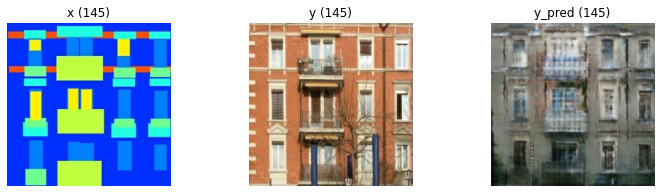

Epoch 147/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3564 - D_loss_true_images: 0.3722 - D_loss_gen_images: 0.3407 - G_loss: 16.5449 - G_loss_GAN: 2.1035 - G_loss_f1: 0.1444
Epoch 148/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3561 - D_loss_true_images: 0.3718 - D_loss_gen_images: 0.3404 - G_loss: 16.5365 - G_loss_GAN: 2.1076 - G_loss_f1: 0.1443
Epoch 149/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3557 - D_loss_true_images: 0.3713 - D_loss_gen_images: 0.3402 - G_loss: 16.5280 - G_loss_GAN: 2.1117 - G_loss_f1: 0.1442
Epoch 150/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3554 - D_loss_true_images: 0.3709 - D_loss_gen_images: 0.3399 - G_loss: 16.5206 - G_loss_GAN: 2.1157 - G_loss_f1: 0.1440
Epoch 151/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3550 - D_loss_true_images: 0.3704 - D_loss_gen_images: 0.3396 - G_loss: 16.5127 - G_loss_GAN: 2.1197 

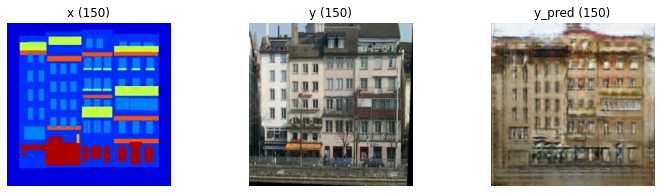

Epoch 152/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3547 - D_loss_true_images: 0.3700 - D_loss_gen_images: 0.3394 - G_loss: 16.5037 - G_loss_GAN: 2.1236 - G_loss_f1: 0.1438
Epoch 153/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3543 - D_loss_true_images: 0.3695 - D_loss_gen_images: 0.3391 - G_loss: 16.4956 - G_loss_GAN: 2.1278 - G_loss_f1: 0.1437
Epoch 154/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3539 - D_loss_true_images: 0.3690 - D_loss_gen_images: 0.3388 - G_loss: 16.4876 - G_loss_GAN: 2.1321 - G_loss_f1: 0.1436
Epoch 155/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3536 - D_loss_true_images: 0.3686 - D_loss_gen_images: 0.3385 - G_loss: 16.4791 - G_loss_GAN: 2.1362 - G_loss_f1: 0.1434
Epoch 156/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3533 - D_loss_true_images: 0.3683 - D_loss_gen_images: 0.3383 - G_loss: 16.4697 - G_loss_GAN: 2.1393 

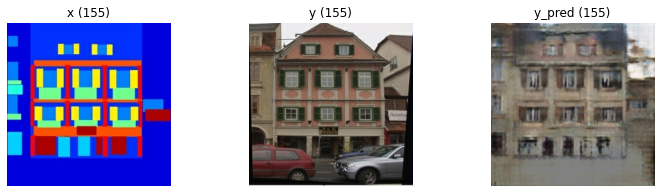

Epoch 157/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3529 - D_loss_true_images: 0.3678 - D_loss_gen_images: 0.3381 - G_loss: 16.4614 - G_loss_GAN: 2.1432 - G_loss_f1: 0.1432
Epoch 158/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3526 - D_loss_true_images: 0.3674 - D_loss_gen_images: 0.3378 - G_loss: 16.4534 - G_loss_GAN: 2.1474 - G_loss_f1: 0.1431
Epoch 159/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3522 - D_loss_true_images: 0.3669 - D_loss_gen_images: 0.3374 - G_loss: 16.4462 - G_loss_GAN: 2.1520 - G_loss_f1: 0.1429
Epoch 160/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3518 - D_loss_true_images: 0.3664 - D_loss_gen_images: 0.3372 - G_loss: 16.4377 - G_loss_GAN: 2.1562 - G_loss_f1: 0.1428
Epoch 161/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3514 - D_loss_true_images: 0.3660 - D_loss_gen_images: 0.3369 - G_loss: 16.4300 - G_loss_GAN: 2.1603 

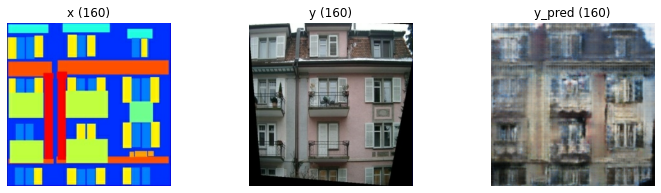

Epoch 162/250
200/200 [==============================] - 11s 43ms/step - D_loss: 0.3511 - D_loss_true_images: 0.3655 - D_loss_gen_images: 0.3366 - G_loss: 16.4227 - G_loss_GAN: 2.1645 - G_loss_f1: 0.1426
Epoch 163/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3507 - D_loss_true_images: 0.3651 - D_loss_gen_images: 0.3363 - G_loss: 16.4150 - G_loss_GAN: 2.1685 - G_loss_f1: 0.1425
Epoch 164/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3503 - D_loss_true_images: 0.3646 - D_loss_gen_images: 0.3361 - G_loss: 16.4077 - G_loss_GAN: 2.1726 - G_loss_f1: 0.1424
Epoch 165/250
200/200 [==============================] - 11s 43ms/step - D_loss: 0.3500 - D_loss_true_images: 0.3642 - D_loss_gen_images: 0.3358 - G_loss: 16.3997 - G_loss_GAN: 2.1766 - G_loss_f1: 0.1422
Epoch 166/250
200/200 [==============================] - 11s 43ms/step - D_loss: 0.3496 - D_loss_true_images: 0.3638 - D_loss_gen_images: 0.3355 - G_loss: 16.3928 - G_loss_GAN: 2.1804 

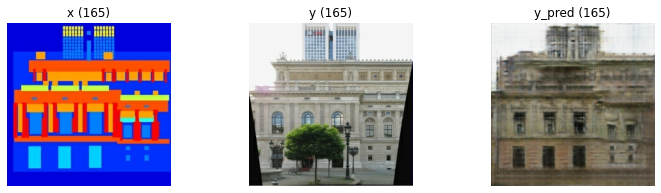

Epoch 167/250
200/200 [==============================] - 11s 43ms/step - D_loss: 0.3493 - D_loss_true_images: 0.3634 - D_loss_gen_images: 0.3352 - G_loss: 16.3851 - G_loss_GAN: 2.1845 - G_loss_f1: 0.1420
Epoch 168/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3490 - D_loss_true_images: 0.3629 - D_loss_gen_images: 0.3350 - G_loss: 16.3778 - G_loss_GAN: 2.1884 - G_loss_f1: 0.1419
Epoch 169/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3487 - D_loss_true_images: 0.3626 - D_loss_gen_images: 0.3348 - G_loss: 16.3705 - G_loss_GAN: 2.1920 - G_loss_f1: 0.1418
Epoch 170/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3483 - D_loss_true_images: 0.3621 - D_loss_gen_images: 0.3345 - G_loss: 16.3633 - G_loss_GAN: 2.1958 - G_loss_f1: 0.1417
Epoch 171/250
200/200 [==============================] - 11s 42ms/step - D_loss: 0.3479 - D_loss_true_images: 0.3616 - D_loss_gen_images: 0.3342 - G_loss: 16.3560 - G_loss_GAN: 2.2002 

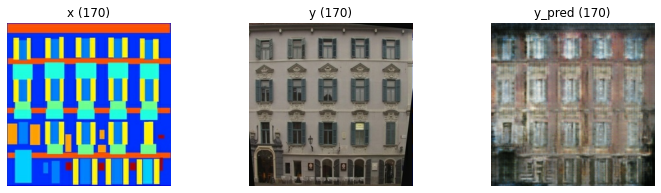

Epoch 172/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3476 - D_loss_true_images: 0.3612 - D_loss_gen_images: 0.3339 - G_loss: 16.3484 - G_loss_GAN: 2.2039 - G_loss_f1: 0.1414
Epoch 173/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3472 - D_loss_true_images: 0.3608 - D_loss_gen_images: 0.3336 - G_loss: 16.3405 - G_loss_GAN: 2.2080 - G_loss_f1: 0.1413
Epoch 174/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3469 - D_loss_true_images: 0.3604 - D_loss_gen_images: 0.3335 - G_loss: 16.3325 - G_loss_GAN: 2.2115 - G_loss_f1: 0.1412
Epoch 175/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3466 - D_loss_true_images: 0.3600 - D_loss_gen_images: 0.3332 - G_loss: 16.3247 - G_loss_GAN: 2.2151 - G_loss_f1: 0.1411
Epoch 176/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3462 - D_loss_true_images: 0.3596 - D_loss_gen_images: 0.3329 - G_loss: 16.3184 - G_loss_GAN: 2.2195 

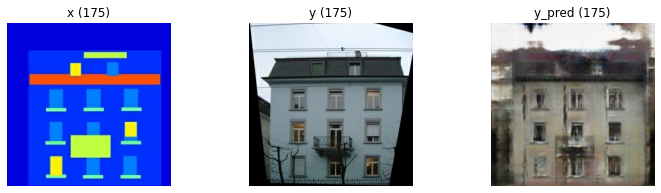

Epoch 177/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3459 - D_loss_true_images: 0.3592 - D_loss_gen_images: 0.3326 - G_loss: 16.3112 - G_loss_GAN: 2.2236 - G_loss_f1: 0.1409
Epoch 178/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3455 - D_loss_true_images: 0.3588 - D_loss_gen_images: 0.3323 - G_loss: 16.3040 - G_loss_GAN: 2.2276 - G_loss_f1: 0.1408
Epoch 179/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3452 - D_loss_true_images: 0.3583 - D_loss_gen_images: 0.3320 - G_loss: 16.2975 - G_loss_GAN: 2.2319 - G_loss_f1: 0.1407
Epoch 180/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3448 - D_loss_true_images: 0.3579 - D_loss_gen_images: 0.3317 - G_loss: 16.2902 - G_loss_GAN: 2.2357 - G_loss_f1: 0.1405
Epoch 181/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3445 - D_loss_true_images: 0.3575 - D_loss_gen_images: 0.3314 - G_loss: 16.2832 - G_loss_GAN: 2.2399 

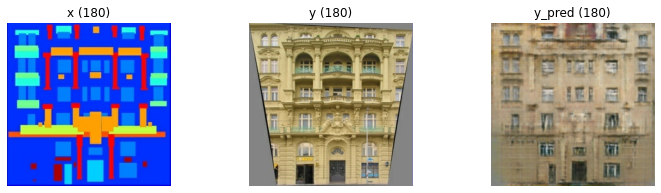

Epoch 182/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3441 - D_loss_true_images: 0.3571 - D_loss_gen_images: 0.3312 - G_loss: 16.2772 - G_loss_GAN: 2.2441 - G_loss_f1: 0.1403
Epoch 183/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3437 - D_loss_true_images: 0.3566 - D_loss_gen_images: 0.3308 - G_loss: 16.2710 - G_loss_GAN: 2.2485 - G_loss_f1: 0.1402
Epoch 184/250
200/200 [==============================] - 12s 41ms/step - D_loss: 0.3434 - D_loss_true_images: 0.3562 - D_loss_gen_images: 0.3306 - G_loss: 16.2636 - G_loss_GAN: 2.2524 - G_loss_f1: 0.1401
Epoch 185/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3431 - D_loss_true_images: 0.3558 - D_loss_gen_images: 0.3304 - G_loss: 16.2568 - G_loss_GAN: 2.2562 - G_loss_f1: 0.1400
Epoch 186/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3428 - D_loss_true_images: 0.3554 - D_loss_gen_images: 0.3301 - G_loss: 16.2505 - G_loss_GAN: 2.2603 

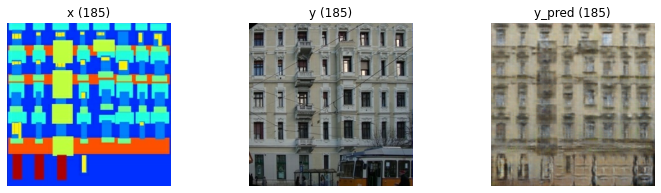

Epoch 187/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3424 - D_loss_true_images: 0.3550 - D_loss_gen_images: 0.3298 - G_loss: 16.2438 - G_loss_GAN: 2.2641 - G_loss_f1: 0.1398
Epoch 188/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3421 - D_loss_true_images: 0.3547 - D_loss_gen_images: 0.3296 - G_loss: 16.2372 - G_loss_GAN: 2.2677 - G_loss_f1: 0.1397
Epoch 189/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3419 - D_loss_true_images: 0.3543 - D_loss_gen_images: 0.3294 - G_loss: 16.2299 - G_loss_GAN: 2.2714 - G_loss_f1: 0.1396
Epoch 190/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3416 - D_loss_true_images: 0.3540 - D_loss_gen_images: 0.3292 - G_loss: 16.2231 - G_loss_GAN: 2.2748 - G_loss_f1: 0.1395
Epoch 191/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3413 - D_loss_true_images: 0.3536 - D_loss_gen_images: 0.3290 - G_loss: 16.2164 - G_loss_GAN: 2.2783 

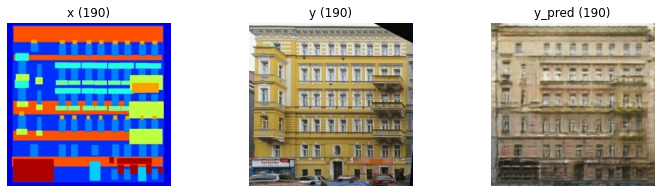

Epoch 192/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3411 - D_loss_true_images: 0.3533 - D_loss_gen_images: 0.3288 - G_loss: 16.2091 - G_loss_GAN: 2.2816 - G_loss_f1: 0.1393
Epoch 193/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3407 - D_loss_true_images: 0.3529 - D_loss_gen_images: 0.3285 - G_loss: 16.2023 - G_loss_GAN: 2.2852 - G_loss_f1: 0.1392
Epoch 194/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3404 - D_loss_true_images: 0.3525 - D_loss_gen_images: 0.3283 - G_loss: 16.1961 - G_loss_GAN: 2.2891 - G_loss_f1: 0.1391
Epoch 195/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3401 - D_loss_true_images: 0.3522 - D_loss_gen_images: 0.3280 - G_loss: 16.1893 - G_loss_GAN: 2.2927 - G_loss_f1: 0.1390
Epoch 196/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3398 - D_loss_true_images: 0.3518 - D_loss_gen_images: 0.3278 - G_loss: 16.1832 - G_loss_GAN: 2.2965 

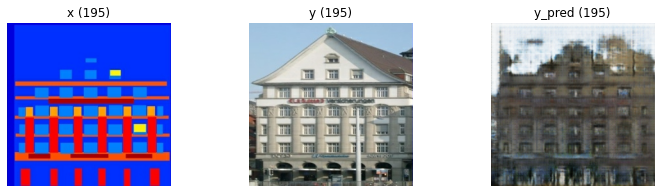

Epoch 197/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3395 - D_loss_true_images: 0.3514 - D_loss_gen_images: 0.3275 - G_loss: 16.1771 - G_loss_GAN: 2.3004 - G_loss_f1: 0.1388
Epoch 198/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3391 - D_loss_true_images: 0.3510 - D_loss_gen_images: 0.3272 - G_loss: 16.1715 - G_loss_GAN: 2.3044 - G_loss_f1: 0.1387
Epoch 199/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3388 - D_loss_true_images: 0.3506 - D_loss_gen_images: 0.3269 - G_loss: 16.1659 - G_loss_GAN: 2.3084 - G_loss_f1: 0.1386
Epoch 200/250
200/200 [==============================] - 12s 43ms/step - D_loss: 0.3385 - D_loss_true_images: 0.3502 - D_loss_gen_images: 0.3267 - G_loss: 16.1599 - G_loss_GAN: 2.3121 - G_loss_f1: 0.1385
Epoch 201/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3382 - D_loss_true_images: 0.3499 - D_loss_gen_images: 0.3264 - G_loss: 16.1539 - G_loss_GAN: 2.3156 

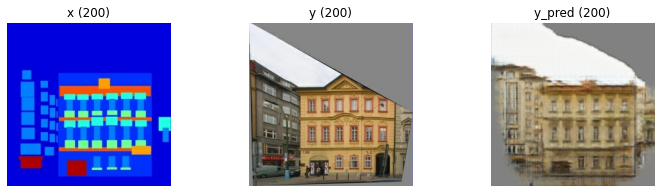

Epoch 202/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3378 - D_loss_true_images: 0.3495 - D_loss_gen_images: 0.3261 - G_loss: 16.1478 - G_loss_GAN: 2.3195 - G_loss_f1: 0.1383
Epoch 203/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3375 - D_loss_true_images: 0.3492 - D_loss_gen_images: 0.3259 - G_loss: 16.1417 - G_loss_GAN: 2.3233 - G_loss_f1: 0.1382
Epoch 204/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3372 - D_loss_true_images: 0.3488 - D_loss_gen_images: 0.3257 - G_loss: 16.1360 - G_loss_GAN: 2.3270 - G_loss_f1: 0.1381
Epoch 205/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3369 - D_loss_true_images: 0.3485 - D_loss_gen_images: 0.3254 - G_loss: 16.1305 - G_loss_GAN: 2.3307 - G_loss_f1: 0.1380
Epoch 206/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3367 - D_loss_true_images: 0.3481 - D_loss_gen_images: 0.3252 - G_loss: 16.1241 - G_loss_GAN: 2.3341 

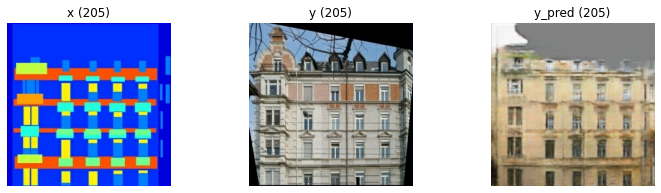

Epoch 207/250
200/200 [==============================] - 12s 42ms/step - D_loss: 0.3363 - D_loss_true_images: 0.3477 - D_loss_gen_images: 0.3249 - G_loss: 16.1187 - G_loss_GAN: 2.3379 - G_loss_f1: 0.1378
Epoch 208/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3360 - D_loss_true_images: 0.3474 - D_loss_gen_images: 0.3246 - G_loss: 16.1128 - G_loss_GAN: 2.3419 - G_loss_f1: 0.1377
Epoch 209/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3357 - D_loss_true_images: 0.3470 - D_loss_gen_images: 0.3244 - G_loss: 16.1070 - G_loss_GAN: 2.3457 - G_loss_f1: 0.1376
Epoch 210/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3353 - D_loss_true_images: 0.3466 - D_loss_gen_images: 0.3241 - G_loss: 16.1013 - G_loss_GAN: 2.3496 - G_loss_f1: 0.1375
Epoch 211/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3350 - D_loss_true_images: 0.3462 - D_loss_gen_images: 0.3238 - G_loss: 16.0958 - G_loss_GAN: 2.3536 

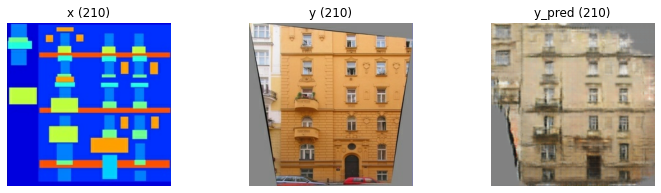

Epoch 212/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3347 - D_loss_true_images: 0.3459 - D_loss_gen_images: 0.3236 - G_loss: 16.0893 - G_loss_GAN: 2.3568 - G_loss_f1: 0.1373
Epoch 213/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3345 - D_loss_true_images: 0.3456 - D_loss_gen_images: 0.3234 - G_loss: 16.0836 - G_loss_GAN: 2.3600 - G_loss_f1: 0.1372
Epoch 214/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3342 - D_loss_true_images: 0.3452 - D_loss_gen_images: 0.3232 - G_loss: 16.0778 - G_loss_GAN: 2.3635 - G_loss_f1: 0.1371
Epoch 215/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3339 - D_loss_true_images: 0.3449 - D_loss_gen_images: 0.3229 - G_loss: 16.0719 - G_loss_GAN: 2.3671 - G_loss_f1: 0.1370
Epoch 216/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3335 - D_loss_true_images: 0.3445 - D_loss_gen_images: 0.3226 - G_loss: 16.0671 - G_loss_GAN: 2.3712 

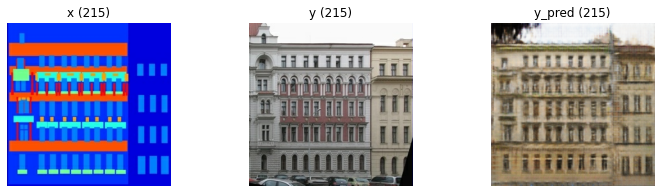

Epoch 217/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3332 - D_loss_true_images: 0.3441 - D_loss_gen_images: 0.3223 - G_loss: 16.0629 - G_loss_GAN: 2.3755 - G_loss_f1: 0.1369
Epoch 218/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3329 - D_loss_true_images: 0.3437 - D_loss_gen_images: 0.3221 - G_loss: 16.0572 - G_loss_GAN: 2.3794 - G_loss_f1: 0.1368
Epoch 219/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3326 - D_loss_true_images: 0.3433 - D_loss_gen_images: 0.3218 - G_loss: 16.0521 - G_loss_GAN: 2.3832 - G_loss_f1: 0.1367
Epoch 220/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3323 - D_loss_true_images: 0.3430 - D_loss_gen_images: 0.3216 - G_loss: 16.0470 - G_loss_GAN: 2.3870 - G_loss_f1: 0.1366
Epoch 221/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3320 - D_loss_true_images: 0.3426 - D_loss_gen_images: 0.3213 - G_loss: 16.0414 - G_loss_GAN: 2.3905 

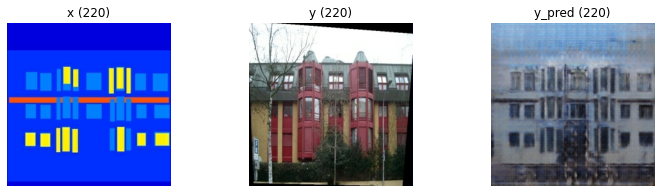

Epoch 222/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3317 - D_loss_true_images: 0.3423 - D_loss_gen_images: 0.3211 - G_loss: 16.0363 - G_loss_GAN: 2.3939 - G_loss_f1: 0.1364
Epoch 223/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3315 - D_loss_true_images: 0.3420 - D_loss_gen_images: 0.3209 - G_loss: 16.0299 - G_loss_GAN: 2.3971 - G_loss_f1: 0.1363
Epoch 224/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3312 - D_loss_true_images: 0.3417 - D_loss_gen_images: 0.3207 - G_loss: 16.0251 - G_loss_GAN: 2.4005 - G_loss_f1: 0.1362
Epoch 225/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3309 - D_loss_true_images: 0.3413 - D_loss_gen_images: 0.3204 - G_loss: 16.0196 - G_loss_GAN: 2.4042 - G_loss_f1: 0.1362
Epoch 226/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3306 - D_loss_true_images: 0.3410 - D_loss_gen_images: 0.3202 - G_loss: 16.0143 - G_loss_GAN: 2.4077 

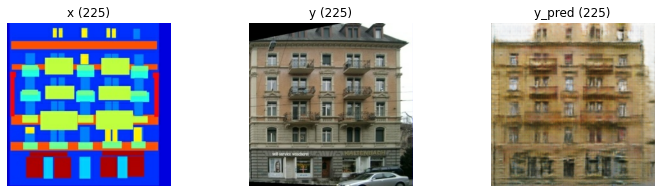

Epoch 227/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3303 - D_loss_true_images: 0.3407 - D_loss_gen_images: 0.3199 - G_loss: 16.0084 - G_loss_GAN: 2.4111 - G_loss_f1: 0.1360
Epoch 228/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3300 - D_loss_true_images: 0.3403 - D_loss_gen_images: 0.3197 - G_loss: 16.0036 - G_loss_GAN: 2.4147 - G_loss_f1: 0.1359
Epoch 229/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3297 - D_loss_true_images: 0.3400 - D_loss_gen_images: 0.3194 - G_loss: 15.9983 - G_loss_GAN: 2.4181 - G_loss_f1: 0.1358
Epoch 230/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3295 - D_loss_true_images: 0.3397 - D_loss_gen_images: 0.3193 - G_loss: 15.9929 - G_loss_GAN: 2.4213 - G_loss_f1: 0.1357
Epoch 231/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3292 - D_loss_true_images: 0.3393 - D_loss_gen_images: 0.3190 - G_loss: 15.9876 - G_loss_GAN: 2.4245 

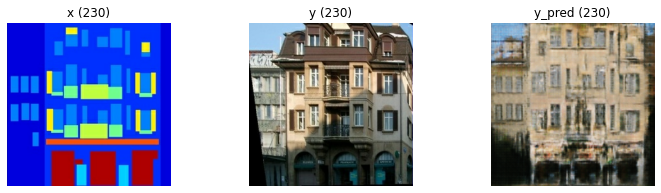

Epoch 232/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3289 - D_loss_true_images: 0.3390 - D_loss_gen_images: 0.3188 - G_loss: 15.9826 - G_loss_GAN: 2.4284 - G_loss_f1: 0.1355
Epoch 233/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3286 - D_loss_true_images: 0.3387 - D_loss_gen_images: 0.3185 - G_loss: 15.9777 - G_loss_GAN: 2.4319 - G_loss_f1: 0.1355
Epoch 234/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3283 - D_loss_true_images: 0.3384 - D_loss_gen_images: 0.3183 - G_loss: 15.9721 - G_loss_GAN: 2.4352 - G_loss_f1: 0.1354
Epoch 235/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3281 - D_loss_true_images: 0.3380 - D_loss_gen_images: 0.3181 - G_loss: 15.9681 - G_loss_GAN: 2.4389 - G_loss_f1: 0.1353
Epoch 236/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3278 - D_loss_true_images: 0.3377 - D_loss_gen_images: 0.3179 - G_loss: 15.9631 - G_loss_GAN: 2.4422 

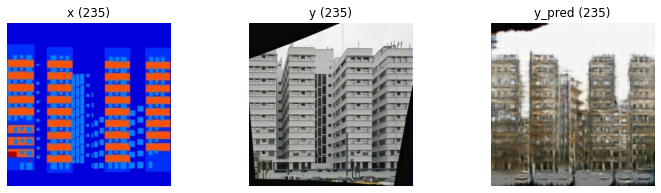

Epoch 237/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3275 - D_loss_true_images: 0.3374 - D_loss_gen_images: 0.3177 - G_loss: 15.9576 - G_loss_GAN: 2.4453 - G_loss_f1: 0.1351
Epoch 238/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3273 - D_loss_true_images: 0.3371 - D_loss_gen_images: 0.3175 - G_loss: 15.9525 - G_loss_GAN: 2.4489 - G_loss_f1: 0.1350
Epoch 239/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3270 - D_loss_true_images: 0.3367 - D_loss_gen_images: 0.3172 - G_loss: 15.9476 - G_loss_GAN: 2.4524 - G_loss_f1: 0.1350
Epoch 240/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3267 - D_loss_true_images: 0.3364 - D_loss_gen_images: 0.3170 - G_loss: 15.9428 - G_loss_GAN: 2.4559 - G_loss_f1: 0.1349
Epoch 241/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3264 - D_loss_true_images: 0.3361 - D_loss_gen_images: 0.3168 - G_loss: 15.9376 - G_loss_GAN: 2.4591 

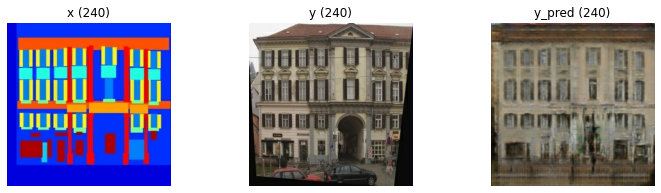

Epoch 242/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3262 - D_loss_true_images: 0.3358 - D_loss_gen_images: 0.3166 - G_loss: 15.9328 - G_loss_GAN: 2.4624 - G_loss_f1: 0.1347
Epoch 243/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3259 - D_loss_true_images: 0.3355 - D_loss_gen_images: 0.3164 - G_loss: 15.9280 - G_loss_GAN: 2.4657 - G_loss_f1: 0.1346
Epoch 244/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3256 - D_loss_true_images: 0.3351 - D_loss_gen_images: 0.3161 - G_loss: 15.9231 - G_loss_GAN: 2.4695 - G_loss_f1: 0.1345
Epoch 245/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3254 - D_loss_true_images: 0.3348 - D_loss_gen_images: 0.3159 - G_loss: 15.9185 - G_loss_GAN: 2.4727 - G_loss_f1: 0.1345
Epoch 246/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3251 - D_loss_true_images: 0.3345 - D_loss_gen_images: 0.3157 - G_loss: 15.9135 - G_loss_GAN: 2.4758 

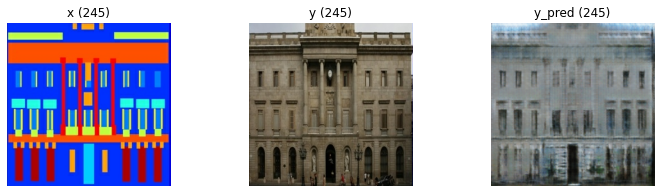

Epoch 247/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3249 - D_loss_true_images: 0.3342 - D_loss_gen_images: 0.3155 - G_loss: 15.9092 - G_loss_GAN: 2.4793 - G_loss_f1: 0.1343
Epoch 248/250
200/200 [==============================] - 13s 43ms/step - D_loss: 0.3246 - D_loss_true_images: 0.3339 - D_loss_gen_images: 0.3153 - G_loss: 15.9046 - G_loss_GAN: 2.4828 - G_loss_f1: 0.1342
Epoch 249/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3243 - D_loss_true_images: 0.3335 - D_loss_gen_images: 0.3150 - G_loss: 15.8999 - G_loss_GAN: 2.4864 - G_loss_f1: 0.1341
Epoch 250/250
200/200 [==============================] - 13s 42ms/step - D_loss: 0.3240 - D_loss_true_images: 0.3332 - D_loss_gen_images: 0.3148 - G_loss: 15.8953 - G_loss_GAN: 2.4899 - G_loss_f1: 0.1341


In [19]:
# Declares all the callbacks
visualize_callback = Visualize_callback()
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

checkpoint_path = "training/cp.ckpt"
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 save_best_only=True,
                                                 monitor='G_loss',
                                                 verbose=False)

model.fit(train_ds.shuffle(500).batch(2), epochs=250, callbacks=[visualize_callback, tensorboard_callback, cp_callback])

# Generate Images

Load the best performing epoch and translate from images to images

****************************************************************************************************


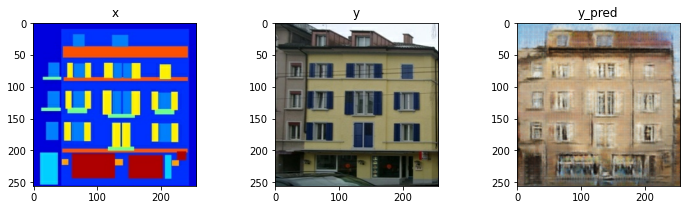

****************************************************************************************************


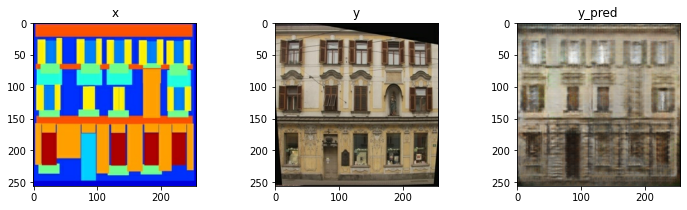

****************************************************************************************************


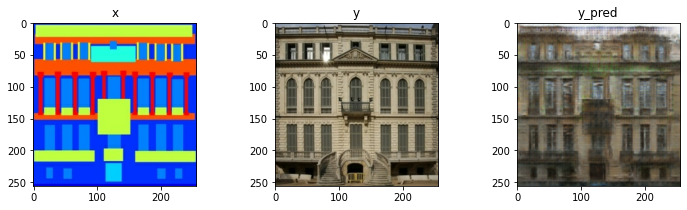

****************************************************************************************************


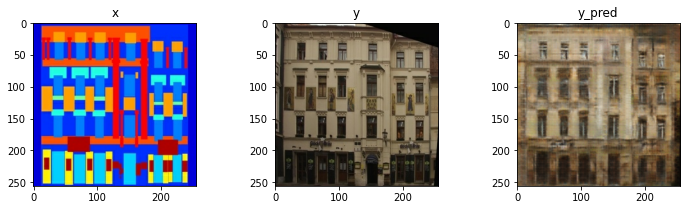

****************************************************************************************************


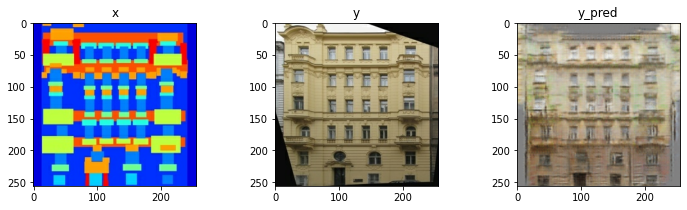

In [20]:
# Create a model and restore from the best checkpoint
model = GAN_model()

checkpoint = tf.train.Checkpoint(model)
checkpoint.restore(checkpoint_path)

# Translate from images to images
for x, y in test_ds.batch(1).take(5):
    print('*'*100)
    y_pred = model.generator(x, training=False)
    plots = {'x': x, 'y': y, 'y_pred': y_pred}
    plt.figure(figsize=(12, 3))
    for idx, (title, img) in enumerate(plots.items()):
        plt.subplot(1, 3, idx + 1)
        plt.imshow(img[0])
        plt.title(title)
    plt.subplots_adjust(wspace=0.3)
    plt.show()

****************************************************************************************************


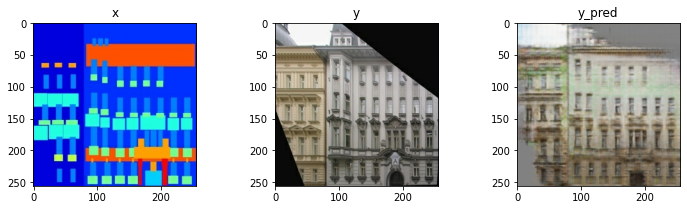

****************************************************************************************************


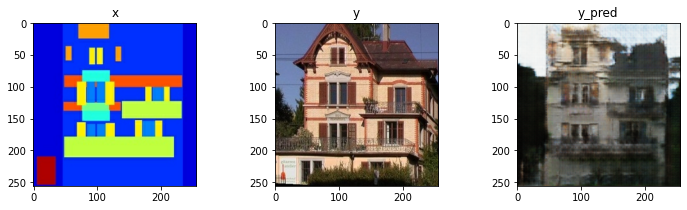

****************************************************************************************************


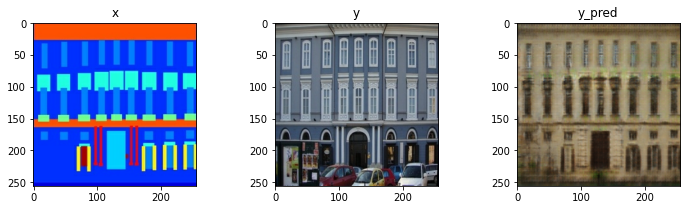

****************************************************************************************************


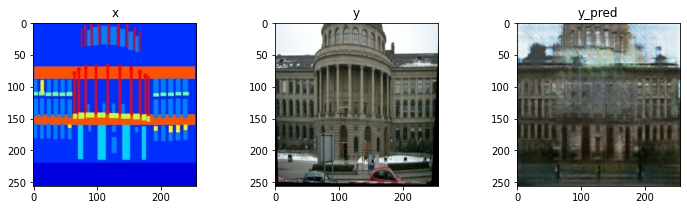

****************************************************************************************************


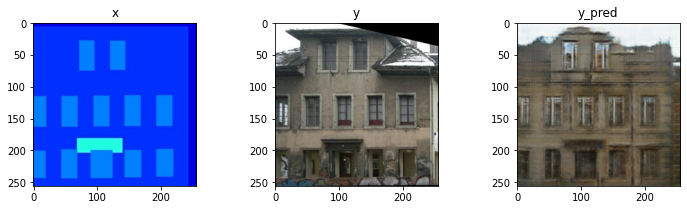

In [21]:
for x, y in test_ds.batch(1).take(5):
    print('*'*100)
    y_pred = model.generator(x, training=False)
    plots = {'x': x, 'y': y, 'y_pred': y_pred}
    plt.figure(figsize=(12, 3))
    for idx, (title, img) in enumerate(plots.items()):
        plt.subplot(1, 3, idx + 1)
        plt.imshow(img[0])
        plt.title(title)
    plt.subplots_adjust(wspace=0.3)
    plt.show()

Cool. We are now at the end of the notebook. Thank you for reading the implementation.